In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

import sctk as sk
import seaborn

In [2]:
# Patient metadata
metadata = pd.read_csv('../data/sample_metadata.csv')
metadata

,GEX_SID,ATAC_SID,GEX,ATAC,Sample,Donor,DOB,Gender,date,age_years,state,disease,site_taken_fine,site_taken_broad,sorted,Nancy_histologic_score,slide_look_other,whole_tissue_signature,scSeq,bulkSeq
0,R01,A01,GX46,NX02,110543,d1,24/10/1951,M,21/06/2018,66,inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue (swapped)",M4M5,RNA+ATAC,ATAC + CD45+RNA
1,R02,A02,GX34,NX10,110544,d1,24/10/1951,M,21/06/2018,66,non-inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,0.0,normal,M6,RNA+ATAC,ATAC + CD45+RNA
2,R03,A03,GX58,NX18,110559,d2,06/01/1987,F,05/07/2018,31,inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue",M6,RNA+ATAC,ATAC + CD45+RNA
3,R04,A04,GX70,NX26,110560,d2,06/01/1987,F,05/07/2018,31,non-inflamed,CD,ascending colon,large intestine,CD45-EPCAM-CD31-THY1+PDPN+,0.0,normal,M6,RNA+ATAC,ATAC + CD45+RNA
4,R05,A05,GX42,NX02,110501,d3,03/06/1976,F,17/05/2018,41,inflamed,CD,descending colon,large intestine,CD45-EPCAM-CD31+THY1+PDPN+,NaN,"502 has ulcers, massive",M4M5,RNA+ATAC,NaN
5,R06,A06,GX54,NX10,110373,d4,21/12/1958,M,22/02/2018,59,inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31+THY1+PDPN+,4.0,some ulcers,M4M5,RNA+ATAC,NaN
6,R07,A07,GX66,NX18,110375,d4,21/12/1958,M,22/02/2018,59,non-inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31+THY1+PDPN+,2.0,some ulcers,M6,RNA+ATAC,NaN
7,R08,A08,GX78,NX26,110614,d5,16/09/1960,F,16/08/2018,57,inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31+THY1+PDPN+,1.0,massive NE and PDPN(slide not consistent with ...,M4M5,RNA+ATAC,NaN
8,R09,A09,GX90,NX34,110615,d5,16/09/1960,F,16/08/2018,57,non-inflamed,CD,colon,large intestine,CD45-EPCAM-CD31+THY1+PDPN+,0.0,normal,M4M5,RNA+ATAC,NaN
9,R10,A10,GX07,NX42,110457,d6,22/12/1994,M,05/04/2018,23,inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31+THY1+PDPN+,4.0,no NE but loads PDPN,M4M5,RNA+ATAC,NaN


In [3]:
# Import processed scRNA-seq data
adata = sc.read('../data/rna/scRNA_batch1_2.processed.h5ad')


In [4]:
adata

AnnData object with n_obs × n_vars = 38116 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'leiden', 'neighbors', 'neighbors_bk', 'pca'
    obsm: 'X_pca', 'X_umap_bk'
    varm: '

In [5]:
adata.obs.annot1.value_counts()

annot1
S3                         8295
S1                         5644
VE postcapillary venlue    4171
VE arterial tip            3218
S3x                        3175
S5                         3103
S2                         3029
LE                         1757
MF1                        1401
PC                         1200
GL                          971
VE capillary                856
S4                          699
VE arterial                 256
MF2                         181
IM                          160
Name: count, dtype: int64

# Replicate original UMAP plot

In [6]:
# Write UMAP embedding to default name, enabling plot call with sc.pl.umap()
adata.obsm['X_umap'] = adata.obsm['X_umap_bk']

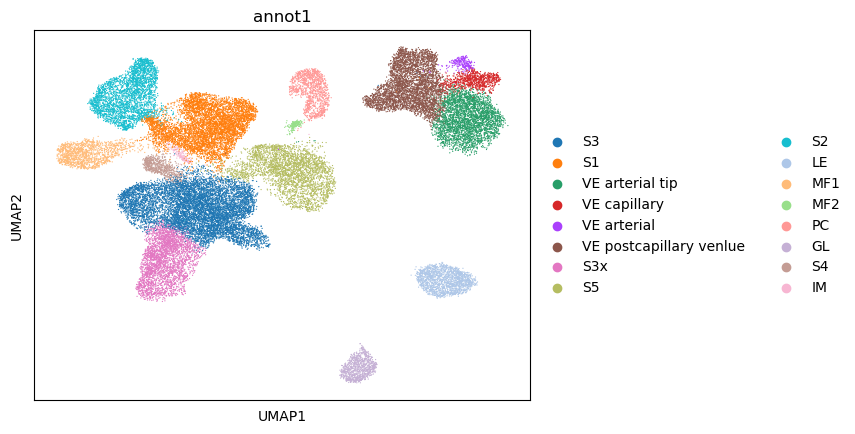

In [7]:
# Plot to ensure that data is identical
sc.pl.umap(adata, color='annot1')

# Filter on fibroblasts, MF, and PC cell populations

In [8]:
# Subset data
select_cells = ['S1', 'S2', 'S3', 'S3x', 'S4', 'S5', 'MF1', 'MF2', 'PC']
adata = adata[adata.obs.annot1.isin(select_cells)]

In [9]:
# Reorder annotation labels
# 
# adata.obs.annot1.cat.reorder_categories([
#     'S1', 'S2', 'S3', 'S3x', 'S4', 'S5', 'MF1', 'MF2', 'PC'
# ], inplace=True)

adata.obs.annot1 = adata.obs.annot1.cat.reorder_categories([
    'S1', 'S2', 'S3', 'S3x', 'S4', 'S5', 'MF1', 'MF2', 'PC'
])

In [10]:
adata

AnnData object with n_obs × n_vars = 26727 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'annot1_colors'
    obsm: 'X_pca', 'X_uma

In [11]:
pd.set_option('display.max_columns', None)
adata.obs

,doublet_bh_pval,n_counts,sample_id,scrublet_score,log1p_n_counts,n_genes,log1p_n_genes,percent_mito,percent_ribo,percent_hb,percent_top50,GEX_SID,ATAC_SID,GEX,ATAC,Sample,DOB,Gender,date,age_years,state,disease,site_taken_fine,site_taken_broad,sorted,Nancy_histologic_score,slide_look_other,whole_tissue_signature,scSeq,bulkSeq,annot_batch1_lr,annot_batch1_lr_prob,annot_batch2_lr,annot_batch2_lr_prob,leiden_bk_r0_1,leiden_bk_r0_3,leiden_bk_r0_5,is_doublet,leiden_bk_split1,leiden_bk_split2,leiden_bk_split3,annot1,leiden_bk_split4,annot_gut_lr,annot_gut_lr_prob,broad_annot1
index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AAACCCATCGTGCTCT-R01,0.737696,1890.0,R01,0.286344,7.544861,888,6.790097,11.322752,16.613756,0.05291,37.989418,R01,A01,GX46,NX02,110544,24/10/1951,M,21/6/2018,66,inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue (swapped?)",high,RNA+ATAC,ATAC + CD45+RNA,S2a,0.859503,S2,0.995781,1,3,6,False,6,6,6,S2,6,WNT5B+ 1,0.253333,S2
AAACGAACATGTTACG-R01,0.737696,2811.0,R01,0.192308,7.941651,1157,7.054450,11.988616,11.028104,0.00000,39.131982,R01,A01,GX46,NX02,110544,24/10/1951,M,21/6/2018,66,inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue (swapped?)",high,RNA+ATAC,ATAC + CD45+RNA,S1,0.998986,S1,0.997381,1,2,1,False,1,1,1,S1,1,WNT2B+ Fos-hi,0.514190,S1
AAACGAAGTTCCGTTC-R01,0.737696,1707.0,R01,0.167630,7.443079,920,6.825460,10.369068,6.268307,0.00000,35.032220,R01,A01,GX46,NX02,110544,24/10/1951,M,21/6/2018,66,inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue (swapped?)",high,RNA+ATAC,ATAC + CD45+RNA,S3,0.999782,S3x,0.987921,0,0,4,False,4,4,4,S3x,4,WNT2B+ Fos-hi,0.294068,S3x
AAACGCTGTCGTTGGC-R01,0.737696,1959.0,R01,0.029213,7.580700,916,6.821107,8.524757,7.197550,0.00000,42.674834,R01,A01,GX46,NX02,110544,24/10/1951,M,21/6/2018,66,inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue (swapped?)",high,RNA+ATAC,ATAC + CD45+RNA,S3,0.999458,S3x,0.999983,0,0,4,False,4,4,4,S3x,4,RSPO3+,0.274607,S3x
AAAGAACCACAAGGTG-R01,0.737696,2126.0,R01,0.122970,7.662468,1181,7.074963,7.808090,8.372530,0.00000,29.586077,R01,A01,GX46,NX02,110544,24/10/1951,M,21/6/2018,66,inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue (swapped?)",high,RNA+ATAC,ATAC + CD45+RNA,S1,0.998682,S1,0.987034,1,2,1,False,1,1,1,S1,1,WNT2B+ Fos-hi,0.303378,S1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTCATTCGATG-R13,0.863149,2774.0,R13,0.067358,7.928406,1154,7.051856,15.176641,9.552992,0.00000,43.583273,R13,A13,GX43,NX82,113395,8/12/1976,F,13/2/2020,43,non-inflamed,CD,ascending colon,large intestine,CD45-EPCAM-CD31+THY1+PDPN+,NaN,nan,nan,RNA+ATAC,nan,S3,0.999980,S3x,0.999763,0,0,4,False,4,4,4,S3x,4,RSPO3+,0.200662,S3x
TTTGGTTGTACTAGCT-R13,0.863149,5568.0,R13,0.142857,8.624970,2121,7.660114,2.209052,18.750000,0.03592,31.016523,R13,A13,GX43,NX82,113395,8/12/1976,F,13/2/2020,43,non-inflamed,CD,ascending colon,large intestine,CD45-EPCAM-CD31+THY1+PDPN+,NaN,nan,nan,RNA+ATAC,nan,S3,0.990997,S3,0.937102,0,0,0,False,"0,0","0,0","0,0",S3,"0,0",RSPO3+,0.231953,S3
TTTGGTTTCGTGGACC-R13,0.863149,4897.0,R13,0.073171,8.496582,2021,7.611842,2.185011,17.868082,0.00000,25.607515,R13,A13,GX43,NX82,113395,8/12/1976,F,13/2/2020,43,non-inflamed,CD,ascending colon,large intestine,CD45-EPCAM-CD31+THY1+PDPN+,NaN,nan,nan,RNA+ATAC,nan,S3,0.996966,S3,0.856868,0,0,0,False,"0,0","0,0","0,0",S3,"0,0",RSPO3+,0.272154,S3


In [12]:
adata.obs.annot1.value_counts()

annot1
S3     8295
S1     5644
S3x    3175
S5     3103
S2     3029
MF1    1401
PC     1200
S4      699
MF2     181
Name: count, dtype: int64

# UMAP reanalysis

In [13]:
sc.tl.umap(adata)  # recalculate UMAP based on bbknn neighborhood graph from Ni.

In [14]:
# Store fibroblast object including recalculated UMAP embedding
adata.write_h5ad("../data/rna/scRNA_batch1_2.processed.fibroblasts.h5ad")

In [15]:
#sc.pl.umap(adata, color=['annot1', 'sample_id', 'site_taken_fine', 'state'])

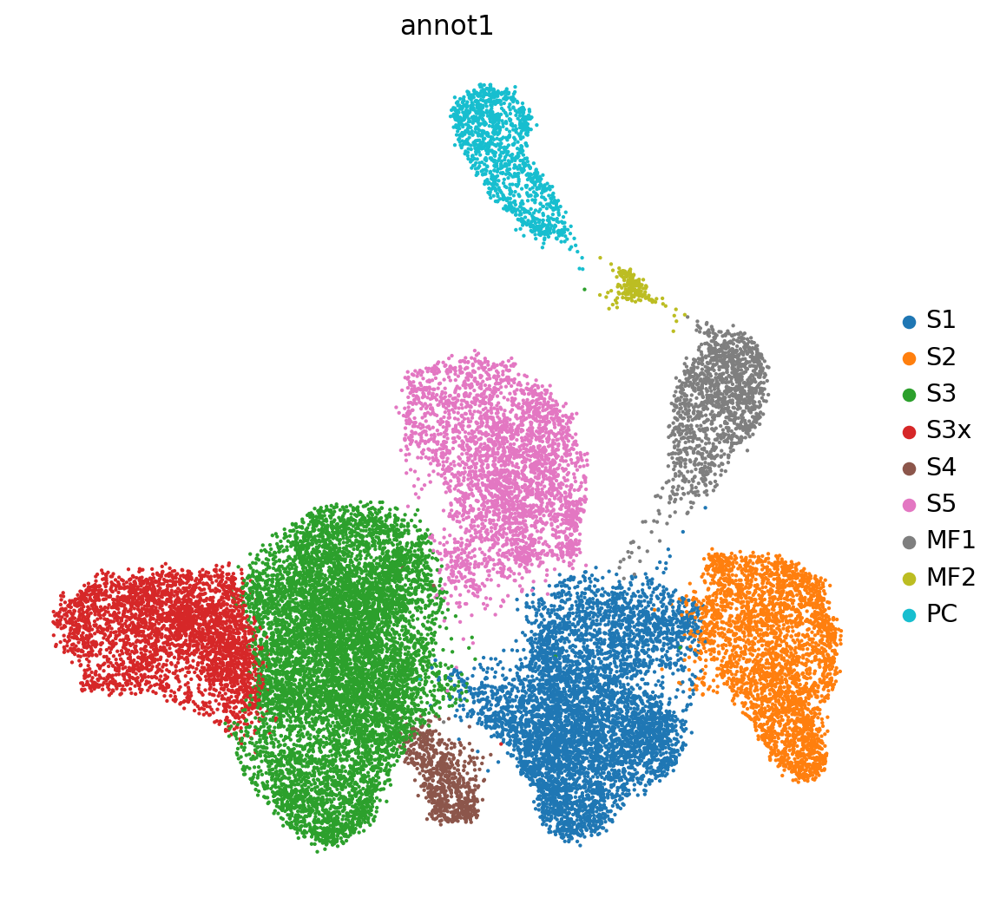

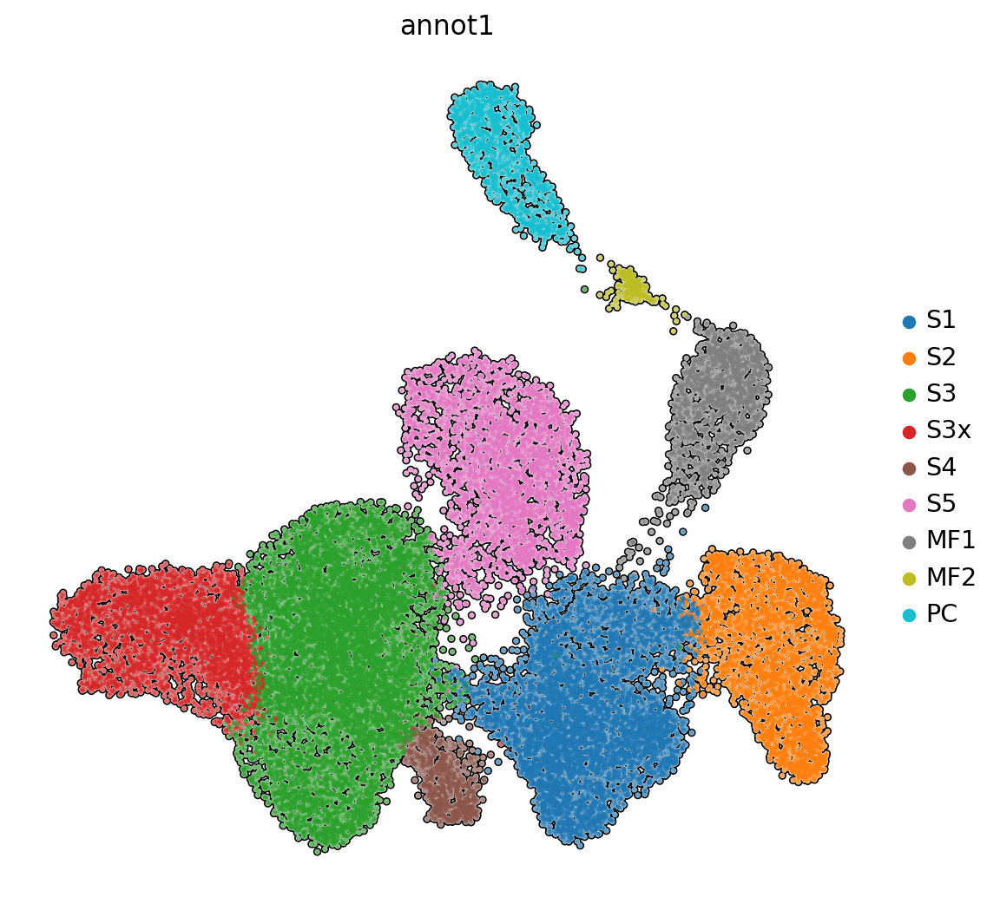

In [16]:
sc.set_figure_params(dpi_save=300, figsize=(8, 8))

# without outline
sc.pl.umap(
    adata,
    color='annot1',
    palette='tab10',
    #palette=sc.plotting.palettes.vega_10_scanpy,  # color blind adjusted, vega10 same as tab10?
    frameon=False,
    size=15,  # point size
    #legend_loc='on data',
    save='UMAP_RNA_fibroblast_MF_PC.pdf'  # in ./figures
)

# with outline
sc.pl.umap(
    adata,
    color='annot1',
    palette='tab10',
    frameon=False,
    size=25,  # point size
    add_outline=True,
    #legend_loc='on data',
    save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
)

In [17]:
# Scanpy additional color palettes
# sc.plotting.palettes.vega_20_scanpy

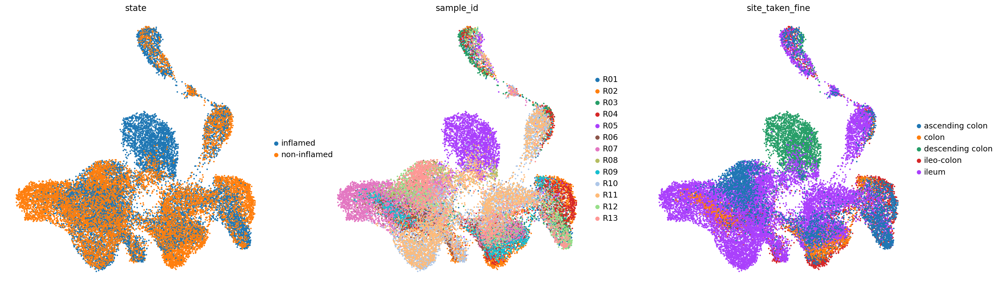

In [18]:
sc.set_figure_params(dpi_save=300, figsize=(8, 8))

# with outline
sc.pl.umap(
    adata,
    #color=['annot1', 'site_taken_fine', 'state'],
    color=['state', 'sample_id', 'site_taken_fine'],
    #palette='tab10',
    palette=sc.plotting.palettes.vega_20_scanpy,
    frameon=False,
    size=25,  # point size
    #add_outline=True,
    #legend_loc='on data',
    #legend_fontsize='large',
    #legend_fontweight='semibold',
    save='UMAP_RNA_fibroblast_MF_PC_covariates.pdf'  # in ./figures
)

# Visualization of cell frequency and clinical metadata

In [19]:
# Cross tabulation
counts = pd.crosstab(adata.obs.annot1, adata.obs.sample_id)
counts

sample_id,R01,R02,R03,R04,R05,R06,R07,R08,R09,R10,R11,R12,R13
annot1,,,,,,,,,,,,,
S1,383,744,314,483,39,415,482,1,435,979,872,166,331
S2,474,661,324,568,42,51,14,0,82,145,84,403,181
S3,538,366,145,328,80,702,1345,282,87,1746,1349,474,853
S3x,51,152,16,11,1,690,1983,33,142,23,24,40,9
S4,7,214,7,63,1,58,0,4,2,248,85,0,10
S5,5,0,0,0,2536,0,1,146,0,117,263,4,31
MF1,29,109,114,149,5,6,12,0,20,572,368,9,8
MF2,18,7,16,7,3,3,67,2,0,23,15,1,19
PC,225,140,342,91,152,12,38,36,6,19,46,57,36


In [20]:
# normalize columns
counts_norm = 100 * counts / counts.sum()
counts_norm = counts_norm.transpose()

In [21]:
metadata

,GEX_SID,ATAC_SID,GEX,ATAC,Sample,Donor,DOB,Gender,date,age_years,state,disease,site_taken_fine,site_taken_broad,sorted,Nancy_histologic_score,slide_look_other,whole_tissue_signature,scSeq,bulkSeq
0,R01,A01,GX46,NX02,110543,d1,24/10/1951,M,21/06/2018,66,inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue (swapped)",M4M5,RNA+ATAC,ATAC + CD45+RNA
1,R02,A02,GX34,NX10,110544,d1,24/10/1951,M,21/06/2018,66,non-inflamed,CD,ileo-colon,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,0.0,normal,M6,RNA+ATAC,ATAC + CD45+RNA
2,R03,A03,GX58,NX18,110559,d2,06/01/1987,F,05/07/2018,31,inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31-THY1+PDPN+,4.0,"ulcers, granulation tissue",M6,RNA+ATAC,ATAC + CD45+RNA
3,R04,A04,GX70,NX26,110560,d2,06/01/1987,F,05/07/2018,31,non-inflamed,CD,ascending colon,large intestine,CD45-EPCAM-CD31-THY1+PDPN+,0.0,normal,M6,RNA+ATAC,ATAC + CD45+RNA
4,R05,A05,GX42,NX02,110501,d3,03/06/1976,F,17/05/2018,41,inflamed,CD,descending colon,large intestine,CD45-EPCAM-CD31+THY1+PDPN+,NaN,"502 has ulcers, massive",M4M5,RNA+ATAC,NaN
5,R06,A06,GX54,NX10,110373,d4,21/12/1958,M,22/02/2018,59,inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31+THY1+PDPN+,4.0,some ulcers,M4M5,RNA+ATAC,NaN
6,R07,A07,GX66,NX18,110375,d4,21/12/1958,M,22/02/2018,59,non-inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31+THY1+PDPN+,2.0,some ulcers,M6,RNA+ATAC,NaN
7,R08,A08,GX78,NX26,110614,d5,16/09/1960,F,16/08/2018,57,inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31+THY1+PDPN+,1.0,massive NE and PDPN(slide not consistent with ...,M4M5,RNA+ATAC,NaN
8,R09,A09,GX90,NX34,110615,d5,16/09/1960,F,16/08/2018,57,non-inflamed,CD,colon,large intestine,CD45-EPCAM-CD31+THY1+PDPN+,0.0,normal,M4M5,RNA+ATAC,NaN
9,R10,A10,GX07,NX42,110457,d6,22/12/1994,M,05/04/2018,23,inflamed,CD,ileum,small intestine,CD45-EPCAM-CD31+THY1+PDPN+,4.0,no NE but loads PDPN,M4M5,RNA+ATAC,NaN


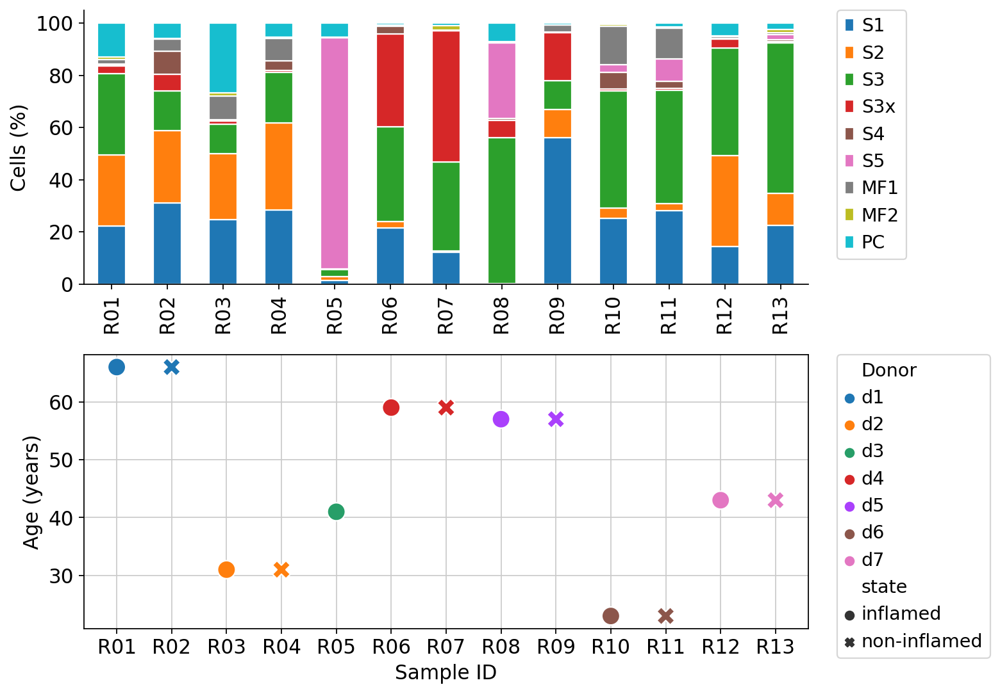

In [22]:
# two plots: stacked barplot and scatter annotation of metadata
fig, axs = plt.subplots(
    nrows=2,
    figsize=(10, 7)  # width x height
) 

# stacked boxplot using pandas.DataFrame.plot
counts_norm.plot(
    ax=axs[0],  # on matplotlib axis
    kind='bar',
    stacked=True,
    grid=False,
    colormap='tab10',  # same color as UMAP
    edgecolor='white',  # color between boxes
    linewidth=1.0  # within stack
)

axs[0].legend(bbox_to_anchor=(1.04, 1), borderaxespad=0)  # legend outside plot, right of bounding box
axs[0].set_ylabel('Cells (%)')
axs[0].set_xlabel('')

# Partially remove plotting frame
axs[0].spines['top'].set_visible(False)
axs[0].spines['right'].set_visible(False)

# Scatterplot
seaborn.scatterplot(
    ax=axs[1],
    x='GEX_SID',
    y='age_years',
    style='state',
    data=metadata,
    hue='Donor',
    s=160  # symbol size for all points
)

# adjust legend
axs[1].legend(bbox_to_anchor=(1.04, 1), borderaxespad=0)  # legend outside plotting area

# xy labels
axs[1].set(ylabel='Age (years)')
axs[1].set(xlabel='Sample ID')

axs[1].set_axisbelow(True)  # grid behind points

fig.tight_layout()  # adjust figure layout, to avoid overlapping text

# save to pdf
plt.savefig('figures/stacked_barplot_celltype_samples.pdf', bbox_inches='tight')

# Fibroblast marker genes

In [23]:
# Identification of marker genes
#sc.tl.rank_genes_groups(adata, groupby='annot1', method='wilcoxon')
sc.tl.rank_genes_groups(adata, groupby='annot1', method='t-test')

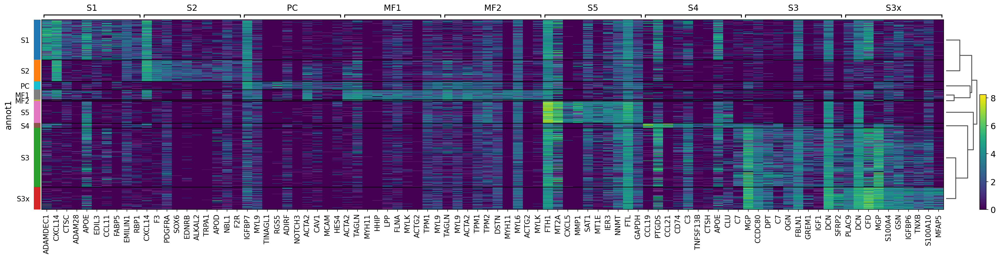

In [24]:
sc.pl.rank_genes_groups_heatmap(adata,
                                show_gene_labels=True)

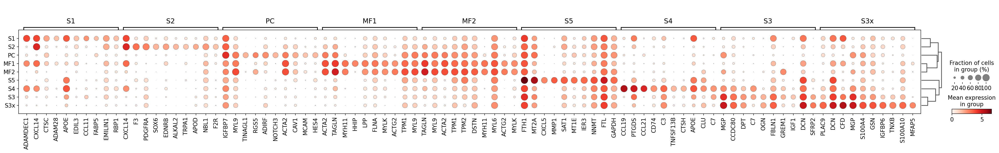

In [25]:
sc.pl.rank_genes_groups_dotplot(adata,
                                save='fibroblast_top10_markers.pdf')

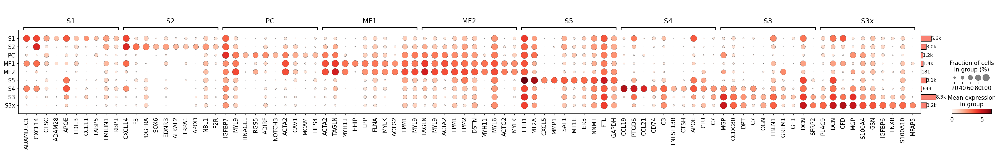

In [26]:
plot = sc.pl.rank_genes_groups_dotplot(
    adata,
    return_fig=True)
plot.add_totals()
#plot.show()
plot.savefig('figures/dotplot_fibroblast_top10_markers_barplot.pdf')

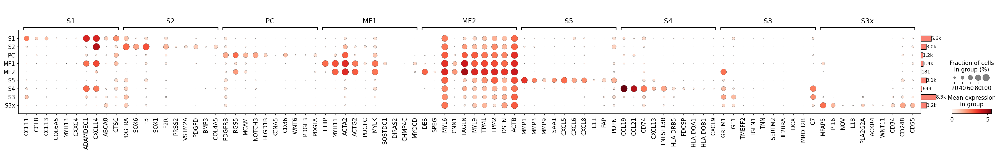

In [27]:
# Plot marers from Matthias, Marker genes_scRNAseq_Matthias_Simon.xlx
marker_dict = {
    'S1': ['CCL11', 'CCL8', 'CCL13', 'COL6A5', 'MYH13', 'CXXC4', 'ADAMDEC1', 'CXCL14', 'ABCA8', 'CTSC'],
    'S2': ['PDGFRA', 'SOX6', 'F3', 'SOX1', 'F2R', 'PRSS2', 'VSTM2A', 'PDGFD', 'BMP3', 'COL4A5'],
    'S3': ['GREM1', 'IGF1', 'TMEFF2', 'IGFN1', 'TNN', 'SERTM2', 'IL20RA', 'DCX', 'MROH2B', 'C7'],
    'S3x': ['MFAP5', 'PI16', 'NOV', 'IL18', 'PLA2G2A', 'ACKR4', 'WNT11', 'CD34', 'CD248', 'CD55'],
    'S4': ['CCL19', 'CCL21', 'CD74', 'CXCL13', 'TNFSF13B', 'HLA-DRB5', 'FDCSP', 'HLA-DQA1', 'HLA-DQB1', 'CXCL9'],
    'S5': ['MMP1', 'MMP3', 'MMP9', 'SAA1', 'CXCL5', 'CXCL6', 'CXCL8', 'IL11', 'FAP', 'PDPN'],
    'MF1': ['HHIP', 'MYH11', 'ACTA2', 'ACTG2', 'PDGFC', 'MYLK', 'SOSTDC1', 'DIRAS2', 'CHMP4C', 'MYOCD'],
    'MF2': ['DES', 'SPEG', 'MYL6', 'CNN1', 'TAGLN', 'MYL9', 'TPM1', 'TPM2', 'DSTN', 'ACTB'],  # MYLK6: SPEG
    'PC': ['PDGFRB', 'RGS5', 'MCAM', 'NOTCH3', 'HIGD1B', 'KCNA5', 'CD36', 'WNT6', 'PDGFB', 'PDGFA']
}

plot = sc.pl.dotplot(adata, var_names=marker_dict, groupby='annot1', return_fig=True, dendrogram=True)
plot.add_totals()
plot.savefig('figures/dotplot_fibroblast_selected_markers_barplot.pdf')

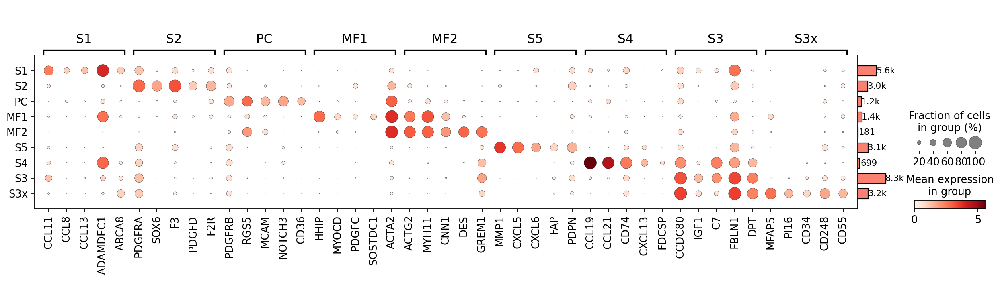

In [28]:
# Plot top-5 selected markers from Matthias, Marker genes_scRNAseq_Matthias_Simon.xlx
marker_dict = {
    'S1': ['CCL11', 'CCL8', 'CCL13', 'ADAMDEC1', 'ABCA8'],
    'S2': ['PDGFRA', 'SOX6', 'F3', 'PDGFD', 'F2R'],
    'S3': ['CCDC80', 'IGF1',  'C7', 'FBLN1', 'DPT'],
    'S3x': ['MFAP5', 'PI16', 'CD34', 'CD248', 'CD55'],
    'S4': ['CCL19', 'CCL21', 'CD74', 'CXCL13', 'FDCSP'],
    'S5': ['MMP1', 'CXCL5', 'CXCL6', 'FAP', 'PDPN'],
    'MF1': ['HHIP', 'MYOCD', 'PDGFC',  'SOSTDC1', 'ACTA2'],
    'MF2': ['ACTG2', 'MYH11', 'CNN1', 'DES', 'GREM1'],
    'PC': ['PDGFRB', 'RGS5', 'MCAM', 'NOTCH3', 'CD36']
}

plot = sc.pl.dotplot(adata, var_names=marker_dict, groupby='annot1', return_fig=True, dendrogram=True)
plot.add_totals()
plot.savefig('figures/dotplot_fibroblast_selected_markers_top5_barplot.pdf')

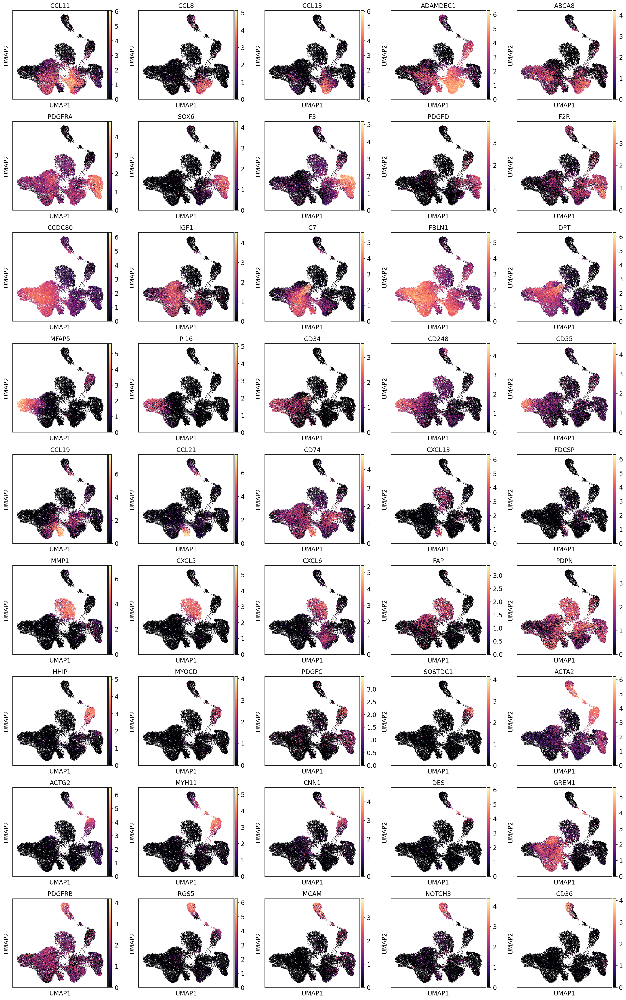

In [29]:
# UMAP of markers
sc.set_figure_params(dpi_save=300)
sc.pl.umap(
    adata,
    color=sum(marker_dict.values(), []),  # gets values of marker dictionary
    #palette='tab10',
    color_map='magma',
    #frameon=False,
    size=5,  # point size
    #add_outline=True,
    ncols=5,
    #legend_loc='on data',
    save='_RNA_fibroblast_MF_PC_top5_markers.pdf'  # in ./figures
)

In [30]:
#plot.savefig

In [31]:
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [32]:
#adata.uns['rank_genes_groups']

In [33]:
adata 

AnnData object with n_obs × n_vars = 26727 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'annot1_colors', 'umap', 'state_colors', 

In [34]:
# Write table of markers to .csv file
sc.get.rank_genes_groups_df(adata, group=None).to_csv(
    'tables/fibroblast_markers_ttest.csv',
    index=False)

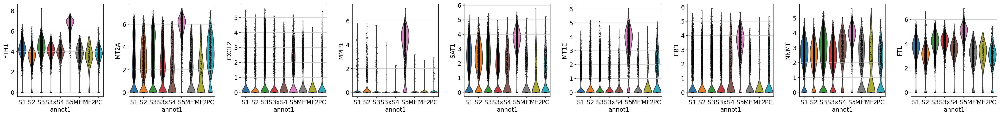

In [35]:
sc.pl.violin(adata,
             ['FTH1', 'MT2A', 'CXCL2', 'MMP1', 'SAT1', 'MT1E', 'IER3', 'NNMT', 'FTL'],
             groupby='annot1',
            save='_S5_top10_markers.pdf')

In [75]:
#import csv

In [39]:
# Antigen presentation genes
# Source: https://www.gsea-msigdb.org/gsea/msigdb/cards/KEGG_ANTIGEN_PROCESSING_AND_PRESENTATION

kegg_antigen = "PSME3,IFI30,KIR3DL3,CREB1,CTSB,CTSL,CTSS,PDIA3,HLA-A,HLA-B,HLA-C,HLA-DMA,HLA-DMB,HLA-DOA,HLA-DOB,HLA-DPA1,HLA-DPB1,HLA-DQA1,HLA-DQA2,HLA-DQB1,HLA-DRA,HLA-DRB1,HLA-DRB3,HLA-DRB4,HLA-DRB5,HLA-E,HLA-F,HLA-G,HSPA1A,HSPA1B,HSPA1L,HSPA2,HSPA4,HSPA5,HSPA6,HSPA8,HSP90AA1,HSP90AB1,IFNA1,IFNA2,IFNA4,IFNA5,IFNA6,IFNA7,IFNA8,IFNA10,IFNA13,IFNA14,IFNA16,IFNA17,IFNA21,KIR2DL1,KIR2DL2,KIR2DL3,KIR2DL4,KIR2DS1,KIR2DS3,KIR2DS4,KIR2DS5,KIR3DL1,KIR3DL2,KLRC1,KLRC2,KLRC3,KLRD1,LTA,CIITA,NFYA,NFYB,NFYC,LGMN,B2M,PSME1,PSME2,KIR2DL5A,RFX5,RFXAP,,TAP1,TAP2,TAPBP,CALR,CANX,KLRC4,RFXANK,CD4,CD8A,CD8B,CD74"
kegg_antigen = kegg_antigen.split(",")

In [46]:
# Overlap with gene symbols
kegg_antigen_overlap = set(adata.var.index) & set(kegg_antigen)
kegg_antigen_overlap

{'B2M',
 'CALR',
 'CANX',
 'CD4',
 'CD74',
 'CIITA',
 'CREB1',
 'CTSB',
 'CTSL',
 'CTSS',
 'HLA-A',
 'HLA-B',
 'HLA-C',
 'HLA-DMA',
 'HLA-DMB',
 'HLA-DOA',
 'HLA-DOB',
 'HLA-DPA1',
 'HLA-DPB1',
 'HLA-DQA1',
 'HLA-DQB1',
 'HLA-DRA',
 'HLA-DRB1',
 'HLA-DRB5',
 'HLA-E',
 'HLA-F',
 'HLA-G',
 'HSP90AA1',
 'HSP90AB1',
 'HSPA1A',
 'HSPA1B',
 'HSPA1L',
 'HSPA2',
 'HSPA4',
 'HSPA5',
 'HSPA6',
 'HSPA8',
 'IFI30',
 'KLRC2',
 'KLRC4',
 'KLRD1',
 'LGMN',
 'NFYA',
 'NFYB',
 'NFYC',
 'PDIA3',
 'PSME1',
 'PSME2',
 'PSME3',
 'RFX5',
 'RFXANK',
 'RFXAP',
 'TAP1',
 'TAP2',
 'TAPBP'}

In [53]:
kegg_antigen_overlap_sel = [
    'CTSS',
    'HLA-DRB1',
    'CD74',
    'HLA-DRB5',
    'HLA-DQB1',
    'HLA-DMA',
    'HLA-DQA1',
    'HLA-DPB1',
    'HLA-DRA'
]

In [50]:
adata

AnnData object with n_obs × n_vars = 26727 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'annot1_colors', 'umap', 'state_colors', 

In [76]:
#adata.uns['rank_genes_groups']

In [79]:
# Get dataframe of marker statistics
tab = sc.get.rank_genes_groups_df(adata, group=None)
tab

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,S1,ADAMDEC1,159.874939,5.405747,0.0,0.0
1,S1,CXCL14,125.151680,4.516617,0.0,0.0
2,S1,CTSC,90.564293,3.222931,0.0,0.0
3,S1,ADAM28,80.568756,4.453521,0.0,0.0
4,S1,APOE,78.096954,2.800548,0.0,0.0
...,...,...,...,...,...,...
158323,PC,LUM,-108.333389,-5.711113,0.0,0.0
158324,PC,CFD,-109.569298,-6.022418,0.0,0.0
158325,PC,MMP2,-127.864479,-5.773814,0.0,0.0
158326,PC,PDGFRA,-129.590958,-6.641641,0.0,0.0


In [106]:
sig_genes = tab.names[(tab.pvals_adj < 0.001) & (tab.group == "S4")].unique()

In [112]:
sig_genes = tab.names[(tab.pvals_adj < 0.001) & (tab.group.isin(["S4", "S5"]))].unique()

In [131]:
sig_genes = tab.names[(tab.pvals_adj < 0.05) & (tab.logfoldchanges > 1) & (tab.group.isin(["S4", "S5"]))].unique()

In [132]:
len(sig_genes)

1932

In [133]:
kegg_antigen_overlap = set(sig_genes) & set(kegg_antigen)
kegg_antigen_overlap

{'CD74',
 'CTSB',
 'CTSS',
 'HLA-DMA',
 'HLA-DMB',
 'HLA-DOA',
 'HLA-DPA1',
 'HLA-DPB1',
 'HLA-DQA1',
 'HLA-DQB1',
 'HLA-DRA',
 'HLA-DRB1',
 'HLA-DRB5',
 'KLRD1',
 'NFYB',
 'PSME2',
 'RFXANK',
 'TAP1'}

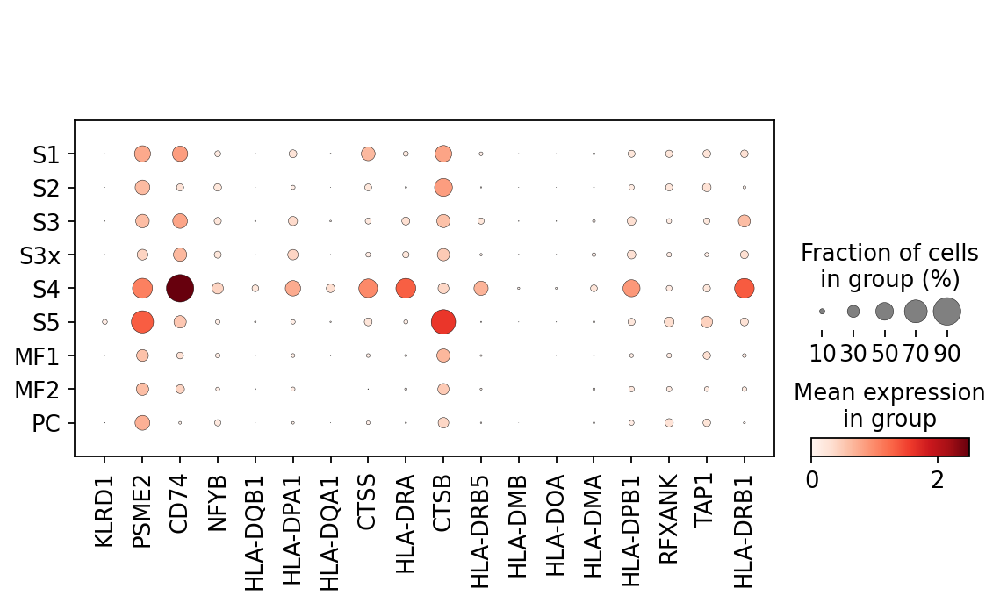

In [137]:
sc.pl.dotplot(adata, groupby="annot1", var_names=list(kegg_antigen_overlap), save="KEGG_antigen_presentation_S4S5.pdf")

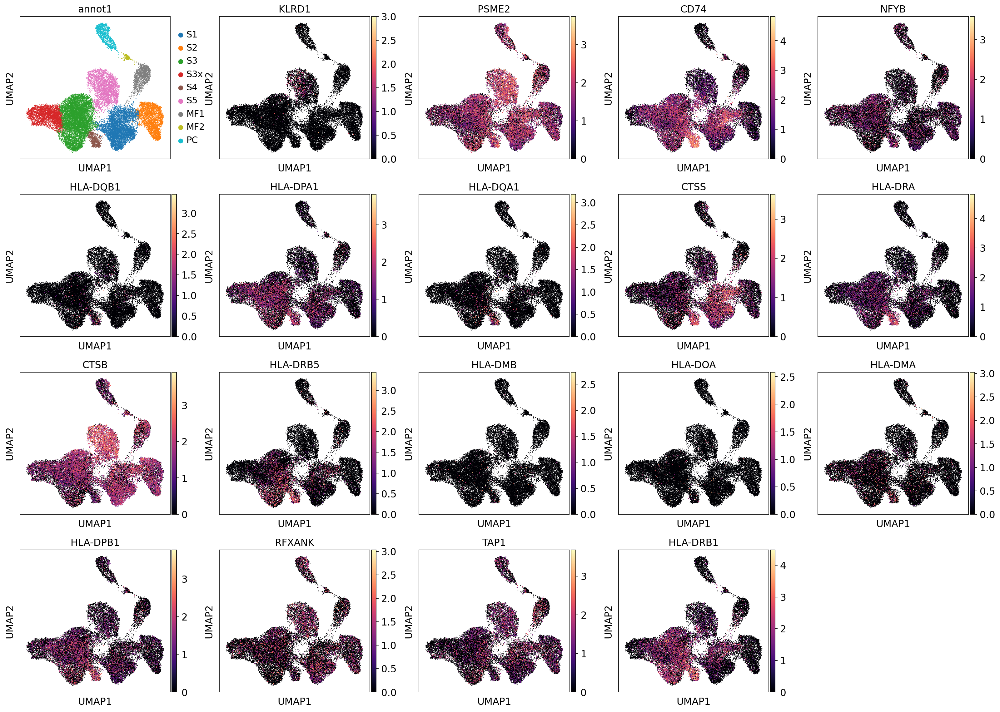

In [136]:

# UMAP of markers
sc.set_figure_params(dpi_save=300)
sc.pl.umap(
    adata,
    #color=kegg_antigen,  # gets values of marker dictionary
    #color=set(adata.var.index) & set(kegg_antigen),  # overlap with gene symbols
    color=["annot1"] + list(kegg_antigen_overlap),
    #palette='tab10',
    color_map='magma',
    #frameon=False,
    size=5,  # point size
    #add_outline=True,
    ncols=5,
    #legend_loc='on data',
    save="_KEGG_antigen_presentation_S4S5.pdf"
)